In [ ]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
Copyright (C) 2021 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# Install mmdetection
!rm -rf mmdetection
!git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection

!pip install -e .
!pip install "mmcv>=2.0.0rc4, <2.2.0"

Cloning into 'mmdetection'...
remote: Enumerating objects: 38023, done.
remote: Counting objects: 100% (2/2), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 38023 (delta 0), reused 1 (delta 0), pack-reused 38021 (from 1)
Receiving objects: 100% (38023/38023), 63.25 MiB | 24.00 MiB/s, done.
Resolving deltas: 100% (26223/26223), done.
/content/mmdetection
Obtaining file:///content/mmdetection
  Preparing metadata (setup.py) ... done
  Running setup.py develop for mmdet
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 471.4/471.4 kB 12.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 451.7/451.7 kB 33.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.7/254.7 kB 22.0 MB/s eta 0:00:00
  Created wheel for mmcv: filename=mmcv-2.1.0-cp310-cp310-linux_x86_64.whl size=38664571 sha256=e3613c654581478e28b3025044723d57e88b07298bc34d

In [ ]:
config_aquarium = """
# Inherit and overwrite part of the config based on this config
_base_ = '/content/mmdetection/configs/faster_rcnn/faster-rcnn_r50_fpn_1x_coco.py'

data_root = '/content/drive/MyDrive/marine_detector/dataset/' # dataset root

train_batch_size_per_gpu = 4  # Adjust batch size according to GPU memory availability
train_num_workers = 2

max_epochs = 20
stage2_num_epochs = 1
base_lr = 0.00008

metainfo = {
    'classes': ('creatures', 'fish', 'jellyfish', 'penguin', 'shark', 'puffin', 'stingray', 'starfish'),
    'palette': [
        (255, 0, 0),        # creatures
        (0, 255, 0),        # Fish
        (255, 105, 180),    # Jellyfish
        (0, 0, 255),        # Penguin
        (255, 165, 0),      # Shark
        (255, 192, 203),    # Puffin
        (128, 0, 128),      # Stingray
        (255, 215, 0),      # Starfish
    ]
}

train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='/content/drive/MyDrive/marine_detector/dataset/train/'),
        ann_file=data_root+'train/_annotations.coco.json'))

val_dataloader = dict(
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='/content/drive/MyDrive/marine_detector/dataset/valid/'),
        ann_file=data_root+'valid/_annotations.coco.json'))

test_dataloader = val_dataloader

val_evaluator = dict(ann_file=data_root + 'valid/_annotations.coco.json')
test_evaluator = val_evaluator

model = dict(
    roi_head=dict(
        bbox_head=dict(num_classes=8)
    )
)

# model = dict(bbox_head=dict(num_classes=8))

# Learning rate schedule
param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=10),
    dict(
        # Use cosine annealing from 10 to 20 epochs
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]

# Optimizer
optim_wrapper = dict(
    _delete_=True,
    type='OptimWrapper',
    optimizer=dict(type='AdamW', lr=base_lr, weight_decay=0.05),
    paramwise_cfg=dict(
        norm_decay_mult=0, bias_decay_mult=0, bypass_duplicate=True),
)

# Default hooks configuration
default_hooks = dict(
    checkpoint=dict(
        interval=5,
        max_keep_ckpts=2,  # Keep only the latest 2 checkpoints
        save_best='auto'
    ),
    logger=dict(type='LoggerHook', interval=5))

# Load pretrained weights
load_from = '/content/drive/MyDrive/marine_detector/checkpoints/faster_rcnn/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth'

# Training configuration
train_cfg = dict(
    type='EpochBasedTrainLoop',
    max_epochs=max_epochs,
    val_interval=1,
)

# Visualization configuration
visualizer = dict(vis_backends=[
    dict(type='LocalVisBackend'),
    dict(type='TensorboardVisBackend')
])
"""

# Save configuration
with open('/content/drive/MyDrive/marine_detector/checkpoints/faster_rcnn/faster_rcnn_aquarium.py', 'w') as f:
    f.write(config_aquarium)


In [ ]:
!python /content/mmdetection/tools/train.py /content/drive/MyDrive/marine_detector/checkpoints/faster_rcnn/faster_rcnn_aquarium.py

/usr/local/lib/python3.10/dist-packages/mmengine/optim/optimizer/zero_optimizer.py:11: DeprecationWarning: `TorchScript` support for functional optimizers is deprecated and will be removed in a future PyTorch release. Consider using the `torch.compile` optimizer instead.
  from torch.distributed.optim import \
09/08 20:26:23 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.10.12 (main, Jul 29 2024, 16:56:48) [GCC 11.4.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 1928845497
    GPU 0: Tesla T4
    CUDA_HOME: /usr/local/cuda
    NVCC: Cuda compilation tools, release 12.2, V12.2.140
    GCC: x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
    PyTorch: 2.4.0+cu121
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture app

CODE TO RUN INFERENCE ON TEST IMAGES

In [ ]:
from mmdet.apis import DetInferencer
import glob
import os

# Choose to use a config
config = '/content/drive/MyDrive/marine_detector/checkpoints/faster_rcnn/faster_rcnn_aquarium.py'

# Setup a checkpoint file to load
checkpoint = glob.glob('/content/mmdetection/work_dirs/faster_rcnn_aquarium/best_coco*.pth')[0]

# Set the device to be used for evaluation
device = 'cuda:0'

# Initialize the DetInferencer
inferencer = DetInferencer(config, checkpoint, device)

# Define the test images folder and output directory
test_images_folder = '/content/drive/MyDrive/marine_detector/dataset/test/'
output_dir = '/content/drive/MyDrive/marine_detector/test_results'

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# Get all images from the test folder
image_paths = glob.glob(os.path.join(test_images_folder, '*.jpg'))  # Adjust the extension if needed (e.g., '*.png')

# Loop through each image and run inference
for img_path in image_paths:
    print(f'Processing {img_path}...')
    result = inferencer(img_path, out_dir=output_dir)

print("Inference complete for all test images.")

In [ ]:
!python /content/mmdetection/tools/test.py \
    /content/drive/MyDrive/marine_detector/checkpoints/faster_rcnn/faster_rcnn_aquarium.py \
    /content/mmdetection/work_dirs/faster_rcnn_aquarium/best_coco_bbox_mAP_epoch_18.pth \
    --out /content/mmdetection/work_dirs/faster_rcnn_aquarium/results.pkl \
    --show

/usr/local/lib/python3.10/dist-packages/mmengine/optim/optimizer/zero_optimizer.py:11: DeprecationWarning: `TorchScript` support for functional optimizers is deprecated and will be removed in a future PyTorch release. Consider using the `torch.compile` optimizer instead.
  from torch.distributed.optim import \
09/08 21:29:46 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.10.12 (main, Jul 29 2024, 16:56:48) [GCC 11.4.0]
    CUDA available: True
    MUSA available: False
    numpy_random_seed: 2048299511
    GPU 0: Tesla T4
    CUDA_HOME: /usr/local/cuda
    NVCC: Cuda compilation tools, release 12.2, V12.2.140
    GCC: x86_64-linux-gnu-gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
    PyTorch: 2.4.0+cu121
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture app

In [ ]:
!python /content/mmdetection/tools/analysis_tools/eval_metric.py \
  /content/drive/MyDrive/marine_detector/checkpoints/faster_rcnn/faster_rcnn_aquarium.py \
  /content/mmdetection/work_dirs/faster_rcnn_aquarium/results.pkl \
  --cfg-options eval=bbox

/usr/local/lib/python3.10/dist-packages/mmengine/optim/optimizer/zero_optimizer.py:11: DeprecationWarning: `TorchScript` support for functional optimizers is deprecated and will be removed in a future PyTorch release. Consider using the `torch.compile` optimizer instead.
  from torch.distributed.optim import \
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
/usr/local/lib/python3.10/dist-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed 

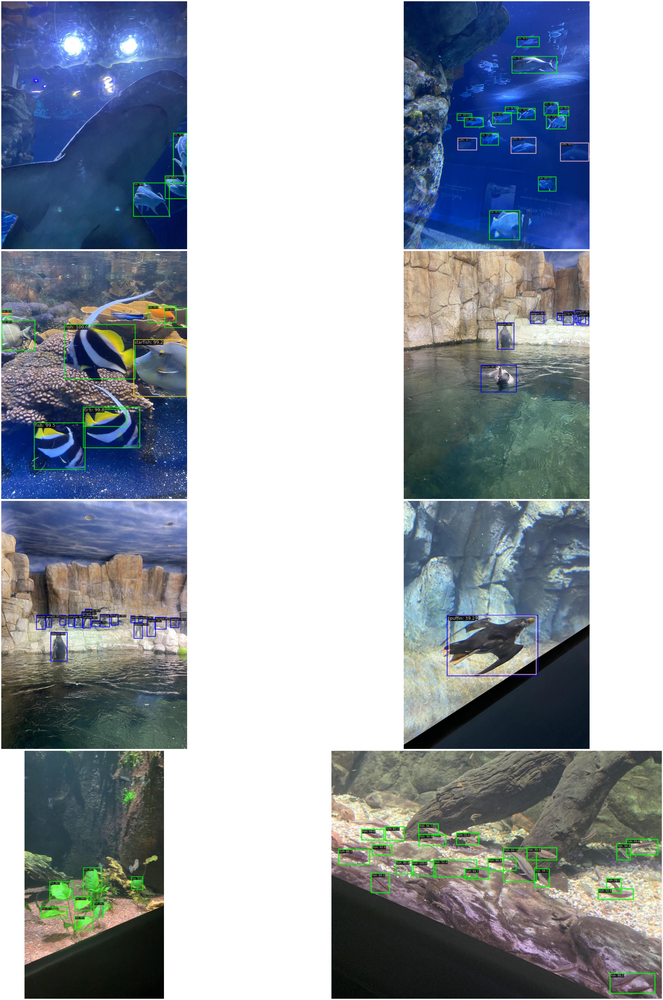

In [6]:
import os
import glob
import matplotlib.pyplot as plt
import cv2  # OpenCV for image loading

# Define the path to the folder containing images
image_folder = '/content/drive/MyDrive/marine_detector/test_results/vis'  # Adjust path as needed
image_paths = glob.glob(os.path.join(image_folder, '*.jpg'))  # Adjust the extension if needed


image_paths = image_paths[:8]

# Set up the figure size and layout (5 rows, 4 columns)
fig, axes = plt.subplots(4, 2, figsize=(80,80))  # Adjust size as needed

# Flatten axes array for easy indexing
axes = axes.flatten()

# Loop through images and display them in the grid
for i, img_path in enumerate(image_paths):
    # Load the image using OpenCV
    img = cv2.imread(img_path)
    # Convert the image from BGR (OpenCV format) to RGB (Matplotlib format)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Display the image on the i-th subplot
    axes[i].imshow(img)
    # axes[i].set_title(os.path.basename(img_path))
    axes[i].axis('off')  # Hide axis labels

# Hide any unused subplots if there are fewer than 20 images
for j in range(len(image_paths), len(axes)):
    axes[j].axis('off')

# Adjust layout and display the figure
plt.tight_layout()
plt.show()
